In [1]:
    #libraries import
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import glob
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix, precision_recall_curve, roc_auc_score, roc_curve, accuracy_score
from keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.model_selection import train_test_split
from functions import *

In [2]:
# data read and types check
df = pd.read_csv("KO-KEGG\KEGG_paths.tsv",sep = "\t",header = None)

df = df.T
colnames=df.iloc[0]
df.columns = colnames
df = df.drop(df.index[0])

print(df.shape)
print(df.dtypes)


<>:2: SyntaxWarning: invalid escape sequence '\K'
<>:2: SyntaxWarning: invalid escape sequence '\K'
C:\Users\marek\AppData\Local\Temp\ipykernel_29028\2627767866.py:2: SyntaxWarning: invalid escape sequence '\K'
  df = pd.read_csv("KO-KEGG\KEGG_paths.tsv",sep = "\t",header = None)
C:\Users\marek\AppData\Local\Temp\ipykernel_29028\2627767866.py:2: SyntaxWarning: invalid escape sequence '\K'
  df = pd.read_csv("KO-KEGG\KEGG_paths.tsv",sep = "\t",header = None)


FileNotFoundError: [Errno 2] No such file or directory: 'KO-KEGG\\KEGG_paths.tsv'

In [ ]:
# as we are missing one row from our Gut_s8 pond we will add it with values 0
# create zero row 
zeros_row = pd.DataFrame([[0] * len(df.columns)], columns=df.columns)
zeros_row['KEGG'] = 'S8.22.Gut'
# add zero row to dataframe
df = pd.concat([df, zeros_row], ignore_index=True)


In [8]:
for col in df.columns[1:]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

In [9]:
print(df.dtypes)
df

0
KEGG        object
ko05340    float64
ko00564    float64
ko00680    float64
ko00562    float64
            ...   
ko00909    float64
ko00905    float64
ko04666    float64
ko04640    float64
ko04912    float64
Length: 223, dtype: object


,KEGG,ko05340,ko00564,ko00680,ko00562,ko03030,ko00561,ko00440,ko00250,ko00740,...,ko00965,ko05131,ko04144,ko00062,ko00901,ko00909,ko00905,ko04666,ko04640,ko04912
0,S8.4.Gut,14007.50,110302.94,147043.18,25747.52,104327.96,66866.22,12596.34,163718.66,35518.04,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,S8.5.Gut,13825.50,108900.72,143767.09,25335.01,116469.23,70930.86,13047.17,167884.58,30465.52,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,S8.2.Gut,17289.25,132540.22,171467.59,31054.76,122604.23,80670.61,15949.92,192464.33,41607.52,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,S8.3.Gut,18899.98,146341.42,186875.44,33138.62,145016.35,93333.18,17887.64,217143.64,43221.99,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,S9.80.Gut,14551.12,108833.22,147673.38,25295.00,87931.76,67850.92,10197.24,153852.12,39231.82,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,S32.73.Gut,14790.25,123736.19,148050.19,18689.08,132018.52,89007.30,7374.74,186244.97,57747.93,...,NaN,3.72,3.72,NaN,NaN,NaN,NaN,NaN,NaN,NaN
121,S32.72.Gut,8609.86,68135.30,100486.04,12440.19,65381.25,45692.15,6406.54,101287.51,29035.93,...,NaN,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
122,S32.75.Gut,7553.47,83516.79,126634.68,11049.46,93353.84,50052.35,2431.97,125494.70,39925.92,...,NaN,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
123,S32.74.Gut,7883.54,58946.18,82612.48,9036.23,58041.86,38942.23,4435.24,86281.02,25553.61,...,NaN,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


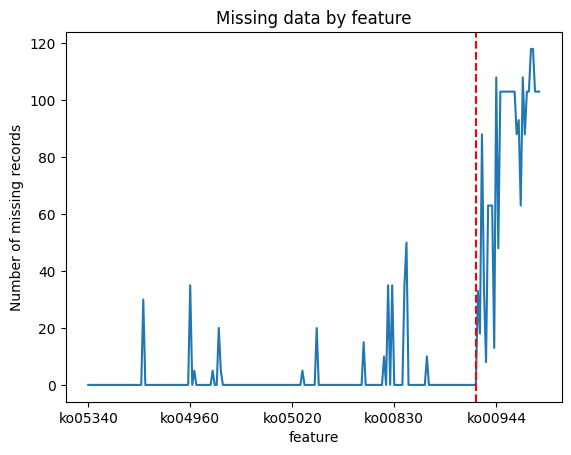

In [10]:
missing_data = (df[1:].isna().sum(axis = 0))

missing_data[1:].plot()
plt.title("Missing data by feature")
plt.xlabel("feature")
plt.ylabel("Number of missing records")
plt.axvline(x=190, color='r', linestyle='--')

In [11]:
# filling missing values with 0 
df = df.fillna(0)
df_2 = df 
df = df_2
df.head()

,KEGG,ko05340,ko00564,ko00680,ko00562,ko03030,ko00561,ko00440,ko00250,ko00740,...,ko00965,ko05131,ko04144,ko00062,ko00901,ko00909,ko00905,ko04666,ko04640,ko04912
0,S8.4.Gut,14007.50,110302.94,147043.18,25747.52,104327.96,66866.22,12596.34,163718.66,35518.04,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,S8.5.Gut,13825.50,108900.72,143767.09,25335.01,116469.23,70930.86,13047.17,167884.58,30465.52,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,S8.2.Gut,17289.25,132540.22,171467.59,31054.76,122604.23,80670.61,15949.92,192464.33,41607.52,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,S8.3.Gut,18899.98,146341.42,186875.44,33138.62,145016.35,93333.18,17887.64,217143.64,43221.99,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,S9.80.Gut,14551.12,108833.22,147673.38,25295.00,87931.76,67850.92,10197.24,153852.12,39231.82,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [12]:
df_cut = df.iloc[:,0:191]
df_cut

,KEGG,ko05340,ko00564,ko00680,ko00562,ko03030,ko00561,ko00440,ko00250,ko00740,...,ko00240,ko04011,ko04113,ko04070,ko03420,ko00770,ko02040,ko00670,ko04920,ko00930
0,S8.4.Gut,14007.50,110302.94,147043.18,25747.52,104327.96,66866.22,12596.34,163718.66,35518.04,...,315674.62,7876.18,261.68,17624.86,46913.22,86708.10,191489.24,85176.42,12678.52,9026.68
1,S8.5.Gut,13825.50,108900.72,143767.09,25335.01,116469.23,70930.86,13047.17,167884.58,30465.52,...,351611.81,10654.84,663.84,18578.68,52166.36,94887.55,142218.12,93023.21,10673.51,6995.34
2,S8.2.Gut,17289.25,132540.22,171467.59,31054.76,122604.23,80670.61,15949.92,192464.33,41607.52,...,373721.56,9279.34,182.34,20586.93,53508.86,100850.05,224047.87,101572.21,15608.26,10772.84
3,S8.3.Gut,18899.98,146341.42,186875.44,33138.62,145016.35,93333.18,17887.64,217143.64,43221.99,...,442535.84,12288.23,519.82,23597.12,64192.15,118746.46,215021.37,118237.73,15981.46,10359.64
4,S9.80.Gut,14551.12,108833.22,147673.38,25295.00,87931.76,67850.92,10197.24,153852.12,39231.82,...,279486.02,5405.46,1149.00,16329.58,39101.02,78835.82,226506.90,77566.06,14168.28,9507.90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,S32.73.Gut,14790.25,123736.19,148050.19,18689.08,132018.52,89007.30,7374.74,186244.97,57747.93,...,427023.59,9084.89,480.00,21093.77,70988.93,107544.13,175322.52,98203.06,19544.10,4824.30
121,S32.72.Gut,8609.86,68135.30,100486.04,12440.19,65381.25,45692.15,6406.54,101287.51,29035.93,...,208435.98,4229.00,539.14,11102.00,34327.00,59547.76,157395.07,53345.68,9428.32,3843.36
122,S32.75.Gut,7553.47,83516.79,126634.68,11049.46,93353.84,50052.35,2431.97,125494.70,39925.92,...,264985.94,6207.49,18.00,14210.97,57127.43,91991.84,220731.79,69414.85,8577.47,1801.98
123,S32.74.Gut,7883.54,58946.18,82612.48,9036.23,58041.86,38942.23,4435.24,86281.02,25553.61,...,188001.64,3752.04,73.84,9138.75,30984.92,50302.60,104088.59,46006.47,8758.80,2849.24


Becouse we have a lot of big numbers and a lot of variation between collumns we might try to normalise the data for better results, on the other hand we could also not normalise so itll be easier for model to discover differences between bacteria abduance as a predictor value. our next steps are:
- plot our data to see for any outliers (ask prof) ew. outlier treatment 
- convert classification variable (target variable)
- create predictors and target varaiable sets
- normalise predictors set 

## Data formatting and normalisation

In [13]:
# replacing zeroes with small number
#f.iloc[:,1:] = df.iloc[:,1:].replace(0,0.00001)

In [14]:
#normalisation by collumns
#df[predictors]=df[predictors]/df[predictors].max()

#normalisation by rows but only for not aggregated  data (not used now)
df.iloc[:,1:] = df.iloc[:,1:].apply(lambda row: row / row.max(axis=0), axis=0)

# for truncated dataset (witout collumns with a lot of missing values)
df_cut.iloc[:,1:] = df_cut.iloc[:,1:].apply(lambda row: row / row.max(axis=0), axis=0)

#checksum
#df.iloc[1,1:].sum()

In [15]:
df.describe()


,ko05340,ko00564,ko00680,ko00562,ko03030,ko00561,ko00440,ko00250,ko00740,ko04940,...,ko00965,ko05131,ko04144,ko00062,ko00901,ko00909,ko00905,ko04666,ko04640,ko04912
count,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,...,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000
mean,0.275654,0.156890,0.145647,0.135593,0.242642,0.128770,0.125152,0.220484,0.192479,0.340544,...,0.041143,0.016302,0.063980,0.028082,0.029961,0.015000,0.015000,0.056000,0.056000,0.056000
std,0.126703,0.111800,0.112758,0.116068,0.123386,0.110637,0.113067,0.119055,0.115593,0.147141,...,0.115722,0.112088,0.204574,0.119187,0.146744,0.118373,0.118373,0.199623,0.199623,0.199623
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.201447,0.114367,0.102765,0.087150,0.173645,0.088427,0.079014,0.164483,0.137760,0.258372,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.264905,0.137720,0.124920,0.110436,0.215844,0.108077,0.108601,0.195307,0.169965,0.316616,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.316760,0.172569,0.147220,0.144675,0.276131,0.132634,0.142064,0.247224,0.204137,0.399367,...,0.035714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## conversion of class variable


Explanation of pond coding
| number | setup | pond numbers | water supplementation | feed suplementation |
|---|---|---|---|---|
|0|control | 8,14,18,24,29|NO|NO|
|1|set 1 | 12,16,19,23,26|Em farma|NO|
|2|set 2 | 10,21,28,30,32|Em farma|EM|
|3|set 3 | 9,13,17,20,27|EM|NO|
|4|set 4 | 11,15,22,25,31|EM|EM|

In [16]:
#creting decoder 

def pond_decoder(x,codes):
    
    x=x.replace('S','')
    num = int(x.split(".")[0])
    
    
    for key, value_list in codes.items():
        if num in value_list:
            return key
    
    return None   
codes = {0 : [8,14,18,24,29], 1: [12,16,19,23,26], 2 : [10,21,28,30,32], 3 : [9,13,17,20,27], 4 : [11,15,22,25,31]}
pond_decoder("S9.80.Gut",codes)

3

## Creating X and y

In [17]:
print(df.shape)
df.tail()

(125, 223)


,KEGG,ko05340,ko00564,ko00680,ko00562,ko03030,ko00561,ko00440,ko00250,ko00740,...,ko00965,ko05131,ko04144,ko00062,ko00901,ko00909,ko00905,ko04666,ko04640,ko04912
120,S32.73.Gut,0.312387,0.175515,0.140456,0.099807,0.325656,0.157940,0.079211,0.262183,0.270731,...,0.0,0.032632,0.31,0.0,0.0,0.0,0.0,0.0,0.0,0.0
121,S32.72.Gut,0.181850,0.096647,0.095332,0.066436,0.161279,0.081079,0.068812,0.142586,0.136125,...,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0
122,S32.75.Gut,0.159538,0.118465,0.120139,0.059009,0.230280,0.088816,0.026122,0.176663,0.187179,...,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0
123,S32.74.Gut,0.166509,0.083613,0.078375,0.048257,0.143174,0.069102,0.047639,0.121460,0.119799,...,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124,S8.22.Gut,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
# creation of X and y 
X = df.iloc[:,1:].to_numpy().astype('float32')
X_cut = df_cut.iloc[:,1:].to_numpy().astype('float32')
#X=X.reshape(125,1,222,1)
y=df['KEGG']
print(X.shape,X_cut.shape,y.shape)


(125, 222) (125, 190) (125,)


In [19]:
# converting y to experimental setups 
codes = {0 : [8,14,18,24,29], 1: [12,16,19,23,26], 2 : [10,21,28,30,32], 3 : [9,13,17,20,27], 4 : [11,15,22,25,31]}
codes2 = {0 : [8,14,18,24,29,12,16,19,23,26,9,13,17,20,27], 1 : [10,21,28,30,32,11,15,22,25,31]}
y5 = np.array([pond_decoder(yi,codes) for yi in y])
y2 = np.array([pond_decoder(yi,codes2) for yi in y])

print(type(y5),type(y2))
print(y5.shape,y2.shape)
print(y[:5],y5[:5],y2[:5])


<class 'numpy.ndarray'> <class 'numpy.ndarray'>
(125,) (125,)
0     S8.4.Gut
1     S8.5.Gut
2     S8.2.Gut
3     S8.3.Gut
4    S9.80.Gut
Name: KEGG, dtype: object [0 0 0 0 3] [0 0 0 0 0]


## Splitting data into train and test sets

In [20]:
#cahnging to category variable
y = pd.DataFrame(y,columns = ['setup'])
y['setup']=y['setup'].astype('float32')


In [21]:
y5 = keras.utils.to_categorical(y5, 5)
y2 = keras.utils.to_categorical(y2, 2)
print(y5[:5],y2[:5])

[[1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.]] [[1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]]


In [22]:
# creating test train and validation set 

X_train5, X_test_, y_train5, y_test_ = train_test_split(X,y5,test_size=0.3,random_state=111,stratify = y5)
X_val5, X_test5, y_val5, y_test5 = train_test_split(X_test_,y_test_,test_size = 0.5, random_state = 111, stratify = y_test_)

print(X_train5.shape,X_val5.shape,X_test5.shape,y_train5.shape,y_val5.shape,y_test5.shape)


(87, 222) (19, 222) (19, 222) (87, 5) (19, 5) (19, 5)


At this point we should have test set with size of 25 and training set with size of 100 ready for later moddeling 

# Model building, compiling, fitting

My initial strategy as we have not much data is to have some more dropout to prevent overfitting and lower learning rate as well as more epochs to compensate for dropout.
- For loss function we will use [caterogical crossentropy](https://keras.io/api/losses/probabilistic_losses/#categoricalcrossentropy-class) as we have several labeled categories
- For metrics we will use [sparse caterogical crossentropy](https://keras.io/api/metrics/probabilistic_metrics/#categoricalcrossentropy-class) as it works well with our integer mutliclass predictor variable
- For optimizer we will chose Adam as it is an usual choice [optimzier choosing](https://towardsdatascience.com/7-tips-to-choose-the-best-optimizer-47bb9c1219e) we will set small learning rate at beggining but it might be that our network will rapidly stop learning becouse of that, in that case it is neccesary to update learning rate to bigger number
- As in this approach we will be building CNN's we will have one 1 dimensional convolutional layer
- No maxpooling layer as we dont want to lose information about position and as it is for temporal data 

## model building and compiling
for now we will build model with 3 hidedn layers with sigmoid activation function as we have no values below zero/one so relu would just predict linear, also one dropout layer and one output layer with softmax activation function.

In [23]:
model1 = keras.Sequential()

model1.add(keras.layers.Dense(256,input_shape=(X_train5.shape[1],),activation='relu'))

model1.add(keras.layers.Dense(32, activation ='relu'))
#model1.add(keras.layers.Dropout(rate=0.2))
model1.add(keras.layers.Dense(16, activation ='relu'))

model1.add(keras.layers.Dense(5, activation ='softmax'))

model1.summary()



C:\Users\marek\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 256)            │        57,088 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 32)             │         8,224 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 5)              │            85 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 65,925 (257.52 KB)

 Trainable params: 65,925 (257.52 KB)

 Non-trainable params: 0 (0.00 B)

In [24]:
es_callback = tf.keras.callbacks.EarlyStopping(patience = 10)

In [25]:
loss = "categorical_crossentropy"
#metrics = "sparse_categorical_crossentropy"
metrics = ["accuracy"]
# worth trying same loss as metrics
optimizer = keras.optimizers.Adam(learning_rate = 0.0001)

model1.compile(optimizer = optimizer, loss = loss, metrics=metrics)

### model fiting 

as we said before we will try to use much epochs and see the results

In [26]:
history1=model1.fit(X_train5, y_train5, epochs = 350, verbose = 1, shuffle = True, batch_size = 3, validation_data = (X_val5, y_val5),callbacks = [es_callback])


Epoch 1/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.1852 - loss: 1.6070 - val_accuracy: 0.2105 - val_loss: 1.5963
Epoch 2/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.2887 - loss: 1.5925 - val_accuracy: 0.2105 - val_loss: 1.5929
Epoch 3/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.3539 - loss: 1.5876 - val_accuracy: 0.3684 - val_loss: 1.5875
Epoch 4/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.3901 - loss: 1.5831 - val_accuracy: 0.2632 - val_loss: 1.5787
Epoch 5/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4719 - loss: 1.5535 - val_accuracy: 0.3158 - val_loss: 1.5657
Epoch 6/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4679 - loss: 1.5499 - val_accuracy: 0.2632 - val_loss: 1.5645
Epoch 7/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.3751 - loss: 1.5506 - val_accuracy: 0.2632 - val_loss: 1.5536
Epoch 8/350
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.3935 - loss: 1.5161 - val_accuracy: 0.3158 - v

# model evaluation

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.4211 - loss: 1.2697
[1.26966392993927, 0.42105263471603394]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Predicted values: [0 4 0 2 0 4 3 3 2 1 1 0 3 1 1 2 4 2 3]
True values: [0 4 0 0 2 0 3 3 4 4 4 2 1 1 3 1 1 2 3]


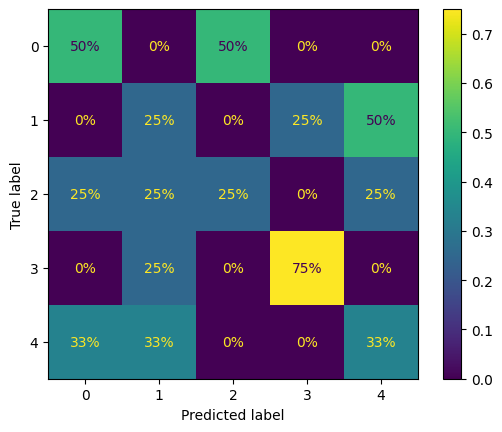

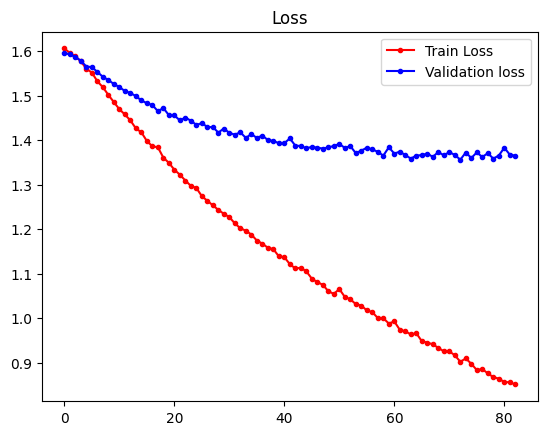

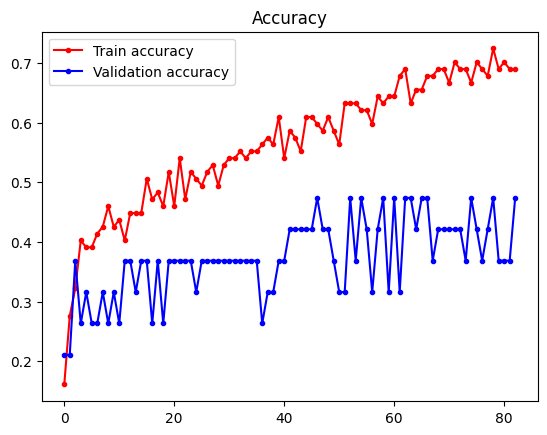

In [27]:
evaluate_model(model1, history1, X_test5, y_test5)

In [28]:
# evaluation for test set
model1.evaluate(X_test5, y_test5)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.4211 - loss: 1.2697


[1.26966392993927, 0.42105263471603394]

In [29]:
y_pred = model1.predict(X)

print(y_pred[:1])
# we need to convert those to classes 
y_pred_class = y_pred.argmax(axis=1)
print(y_pred_class[:1])

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
[[0.39923736 0.32957256 0.02625535 0.13864176 0.10629287]]
[0]


In [30]:
y_pred = model1.predict(X)

print(y_pred[:1])
# we need to convert those to classes 
y_pred_class = y_pred.argmax(axis=1)
print(y_pred_class[:1])

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 999us/step
[[0.39923736 0.32957256 0.02625535 0.13864176 0.10629287]]
[0]


In [31]:
print(y_pred_class)


[0 0 1 0 0 3 3 3 3 2 2 2 4 2 2 4 3 4 2 1 1 1 1 1 3 3 3 3 3 0 0 0 3 0 1 4 1
 4 3 1 1 1 1 1 1 1 1 1 3 0 4 0 1 1 4 3 1 3 3 3 3 1 3 3 4 2 0 0 0 4 3 4 3 4
 1 1 1 1 1 2 1 1 1 0 2 2 3 1 2 2 4 2 1 2 2 3 3 3 4 2 2 2 2 2 0 0 0 0 0 2 2
 2 2 2 2 2 2 4 2 2 2 2 2 2 0]


In [32]:
history1.history.keys() 

dict_keys(['accuracy', 'loss', 'val_accuracy', 'val_loss'])

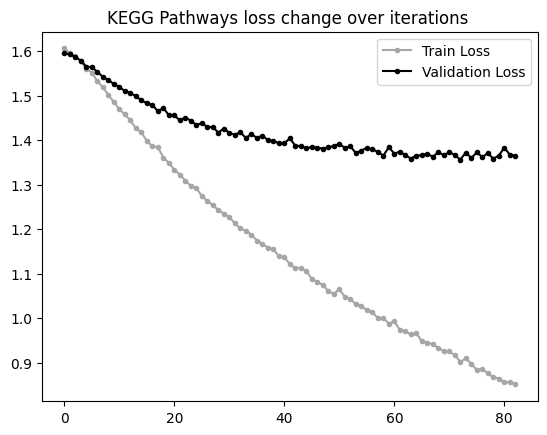

In [61]:
import matplotlib.pyplot as plt

title = "KEGG Pathways loss change over iterations "
fig, ax = plt.subplots()

# Change the colors of the lines
ax.plot(history1.history["loss"], color='#a6a6a6', marker='.', label="Train Loss")
ax.plot(history1.history["val_loss"], color='black', marker='.', label="Validation Loss")

# Change the color of the title
plt.title(title, color='black')

ax.legend()
plt.savefig(title + '.png')

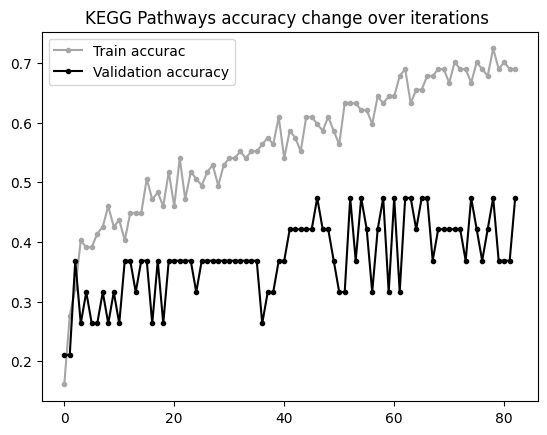

In [60]:
title = "KEGG Pathways accuracy change over iterations "
fig, ax = plt.subplots()
ax.plot(history1.history["accuracy"],color='#a6a6a6', marker='.', label="Train accurac")
ax.plot(history1.history["val_accuracy"],color='black', marker='.', label="Validation accuracy")
plt.title(title)
ax.legend()
plt.savefig(title+'.png')

# Classification for 2 classes

In [35]:

X_train2, X_test_, y_train2, y_test_ = train_test_split(X,y2,test_size=0.3,random_state=111,stratify = y2)
X_val2, X_test2, y_val2, y_test2 = train_test_split(X_test_,y_test_,test_size = 0.5, random_state = 111, stratify = y_test_)

print(X_train2.shape,X_val2.shape,X_test2.shape,y_train2.shape,y_val2.shape,y_test2.shape)


(87, 222) (19, 222) (19, 222) (87, 2) (19, 2) (19, 2)


## model building and compiling
for now we will build model with 3 hidedn layers with sigmoid activation function as we have no values below zero/one so relu would just predict linear, also one dropout layer and one output layer with softmax activation function.

In [36]:
model2 = keras.Sequential()

model2.add(keras.layers.Dense(128,input_shape=(X_train2.shape[1],),activation='relu'))

model2.add(keras.layers.Dense(32, activation ='relu'))
#model1.add(keras.layers.Dropout(rate=0.2))
model2.add(keras.layers.Dense(16, activation ='relu'))

model2.add(keras.layers.Dense(2, activation ='softmax'))

model2.summary()



C:\Users\marek\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 128)            │        28,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 32)             │         4,128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │            34 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 33,234 (129.82 KB)

 Trainable params: 33,234 (129.82 KB)

 Non-trainable params: 0 (0.00 B)

In [37]:
es_callback = tf.keras.callbacks.EarlyStopping(patience = 10)

In [38]:
loss = "categorical_crossentropy"
#metrics = "sparse_categorical_crossentropy"
metrics = ["accuracy"]
# worth trying same loss as metrics
optimizer = keras.optimizers.Adam(learning_rate = 0.0001)

model2.compile(optimizer = optimizer, loss = loss, metrics=metrics)

### model fiting 

as we said before we will try to use much epochs and see the results

In [39]:
history2=model2.fit(X_train2, y_train2, epochs = 350, verbose = 1, shuffle = True, batch_size = 5, validation_data = (X_val2, y_val2),callbacks = [es_callback])


Epoch 1/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5832 - loss: 0.6757 - val_accuracy: 0.6316 - val_loss: 0.6288
Epoch 2/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6253 - loss: 0.6422 - val_accuracy: 0.6316 - val_loss: 0.6199
Epoch 3/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6147 - loss: 0.6169 - val_accuracy: 0.6316 - val_loss: 0.6095
Epoch 4/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5975 - loss: 0.6357 - val_accuracy: 0.6316 - val_loss: 0.6031
Epoch 5/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6791 - loss: 0.5692 - val_accuracy: 0.6316 - val_loss: 0.5974
Epoch 6/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6099 - loss: 0.5782 - val_accuracy: 0.6316 - val_loss: 0.5921
Epoch 7/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5609 - loss: 0.6060 - val_accuracy: 0.6316 - val_loss: 0.5877
Epoch 8/350
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6441 - loss: 0.6093 - val_accuracy: 0.6316 - v

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.8421 - loss: 0.3252
[0.32524242997169495, 0.8421052694320679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Predicted values: [0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 1 1 0 0]
True values: [0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.8421 - loss: 0.2959
[0.2959112823009491, 0.8421052694320679]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted values: [1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1]
True values: [1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1]


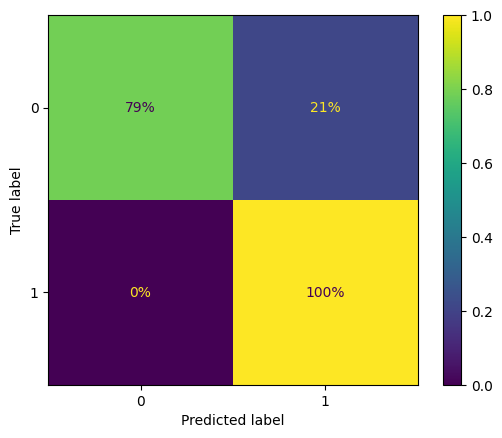

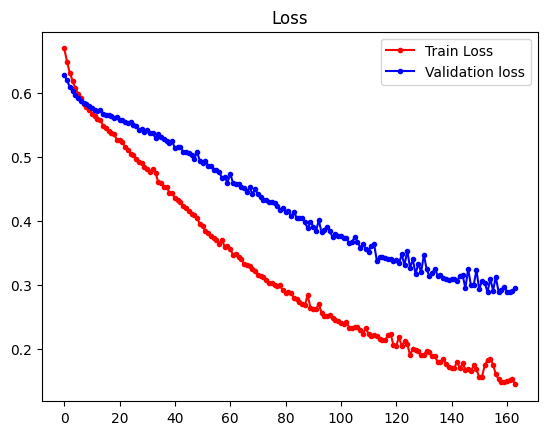

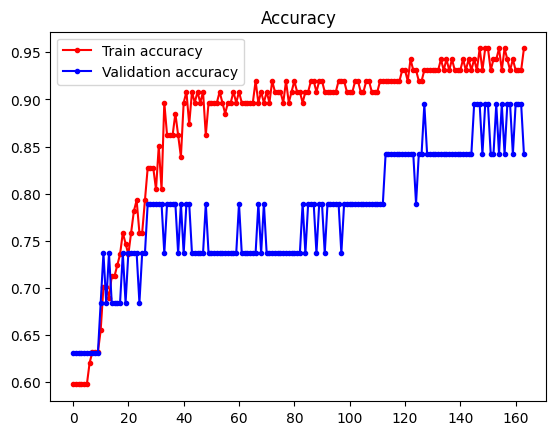

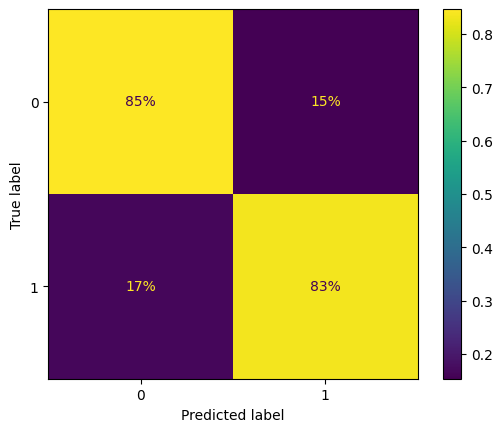

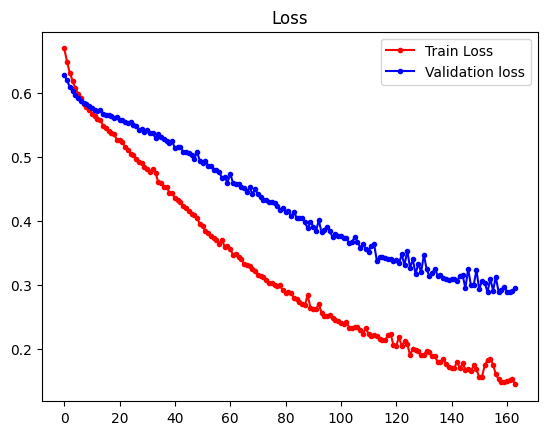

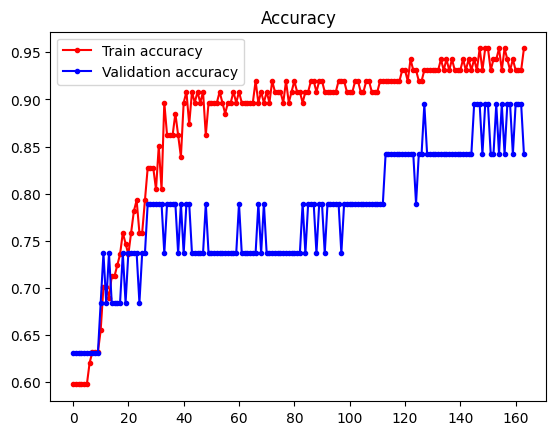

In [40]:
evaluate_model(model2, history2, X_test2, y_test2)
evaluate_model(model2, history2, X_val2, y_val2)

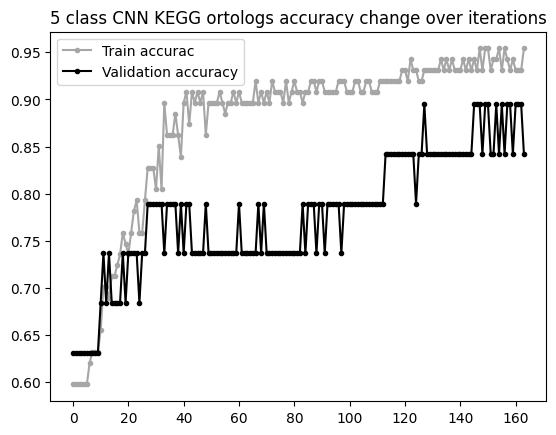

In [59]:
title = "5 class CNN KEGG ortologs accuracy change over iterations"
fig, ax = plt.subplots()
ax.plot(history2.history["accuracy"],'#a6a6a6', marker='.', label="Train accurac")
ax.plot(history2.history["val_accuracy"],'black', marker='.', label="Validation accuracy")
plt.title(title)
ax.legend()

In [44]:
raise SystemExit("Stopping execution")

SystemExit: Stopping execution

C:\Users\marek\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\IPython\core\interactiveshell.py:3585: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


# Feature importance


In [41]:
from IPython.display import clear_output


In [42]:
# creating testing dataset 
df2_test_u = pd.DataFrame(X_test2.copy(),columns = df.columns[1:])
df2_test_u.head()

,ko05340,ko00564,ko00680,ko00562,ko03030,ko00561,ko00440,ko00250,ko00740,ko04940,...,ko00965,ko05131,ko04144,ko00062,ko00901,ko00909,ko00905,ko04666,ko04640,ko04912
0,0.636553,0.339290,0.360867,0.329774,0.575065,0.234305,0.222273,0.553778,0.468329,0.909040,...,1.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
1,0.122213,0.065578,0.063242,0.050606,0.121224,0.051788,0.034585,0.098311,0.091698,0.138223,...,0.007143,0.0,0.0,0.040816,0.019608,0.0,0.0,0.0,0.0,0.0
2,0.244450,0.160354,0.149968,0.195403,0.312413,0.131757,0.089108,0.247069,0.221137,0.374101,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
3,0.630273,0.595985,0.595910,0.596811,0.609276,0.591673,0.576643,0.610607,0.602688,0.548256,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
4,0.228329,0.114775,0.102707,0.100892,0.166558,0.084836,0.103397,0.164483,0.134416,0.274287,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0


In [43]:
# collumn swap with random numbers from uniform distribution (0,1)
results_dfu = pd.DataFrame(columns=['feature_name','feature_number','test_loss', 'test_acc'])
# number of iterations per feature 
N = 100
df2_test_p = df2_test_u

feature_name = [0]*N
feature_number = [0]*N
test_loss = [0]*N
test_acc = [0]*N
for column in df2_test_p.columns:
    
    for i in range(N):
        
        print(f"processing {column}")
        print(f'{i/N*100}% procesing {i} out of {N}')
    
        dfu_test = df2_test_p.copy()


        
        random_numbers_test = np.random.uniform(low=0, high=1, size=(dfu_test.shape[0], 1))

        
    # Update the DataFrame with the permuted column
       
        dfu_test[column] = random_numbers_test
        

    
        ev_test = model2.evaluate(dfu_test, y_test2)

        feature_name[i]=str(column)
        feature_number[i]=i
        test_loss[i]=ev_test[0]
        test_acc[i]=ev_test[1]
        clear_output(wait=True)

    col_df = pd.DataFrame({'feature_name':feature_name,'feature_number':feature_number  ,'test_loss':test_loss ,'test_acc':test_acc })
    
    results_dfu = pd.concat([results_dfu, col_df],ignore_index = True)
    

processing ko04141
22.0% procesing 22 out of 100


KeyboardInterrupt: 

In [ ]:
#results_dfu.to_csv("results_dfu_KEGG_paths.csv")

results_dfu

In [ ]:
results_dfu = pd.read_csv("results_dfu_KEGG_paths.csv")

In [ ]:
results_dfu.groupby('feature_name').mean().sort_values(by = 'test_acc',ascending = True)

,feature_number,test_loss,test_acc
feature_name,,,
ko00902,49.5,1.143495,0.732632
ko04020,49.5,0.455844,0.739474
ko00472,49.5,0.688753,0.753158
ko04960,49.5,0.392948,0.754211
ko00510,49.5,0.376540,0.757895
...,...,...,...
ko04621,49.5,0.275616,0.877368
ko04914,49.5,0.284183,0.877895
ko03420,49.5,0.270159,0.881579


## SHAP values

C:\Users\marek\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
100%|██████████| 19/19 [01:27<00:00,  4.62s/it]


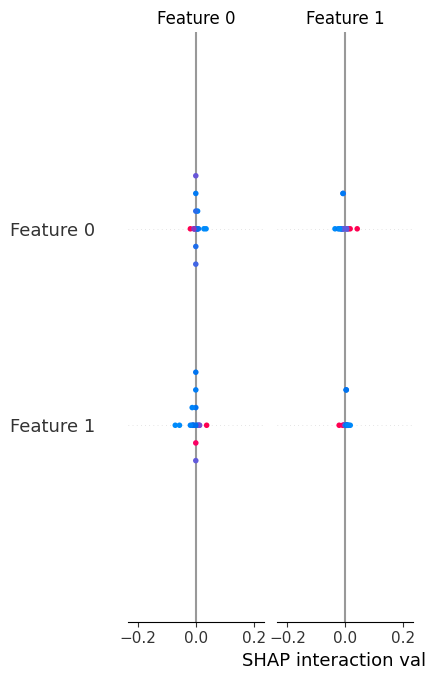

In [ ]:
import shap   

# Create a SHAP explainer object
explainer = shap.KernelExplainer(model2, X_train2)   

# Calculate SHAP values
shap_values = explainer.shap_values(X_test2)   

# Plot the SHAP values
shap.summary_plot(shap_values, X_test2)   


In [ ]:
shap_values[:,:,0]

array([[ 0.        ,  0.00859838,  0.        , ..., -0.00531794,
         0.01522386,  0.        ],
       [ 0.02820819, -0.00951273,  0.00187262, ...,  0.01087808,
         0.00499528,  0.        ],
       [ 0.00526566,  0.0025649 ,  0.00241083, ...,  0.        ,
         0.00541124,  0.0008117 ],
       ...,
       [ 0.00636766, -0.0052022 , -0.00105866, ...,  0.01469372,
         0.00354335,  0.01343995],
       [ 0.        , -0.0039093 ,  0.00105379, ...,  0.        ,
         0.00412958, -0.001194  ],
       [ 0.        ,  0.00482159,  0.        , ...,  0.0020599 ,
        -0.00085117,  0.00182778]])

In [ ]:
# Convert shap_values to a DataFrame
shap_values = shap_values[:,:,1]
shap_df = pd.DataFrame(shap_values)

# Save the DataFrame as a CSV file

#np.to_csv("shap_values.csv")
shap_df.columns = colnames[1:]
shap_df.to_csv("shap_values_KEGG_pathways.csv", index=False)

In [ ]:
shap_df = pd.read_csv("shap_values_KEGG_pathways.csv")

In [ ]:
# First we are going to filter features with mean shap value equal to 0 

# Calculate mean absolute SHAP value for each feature
mean_abs_shap = shap_df.abs().mean().reset_index(drop=True)

# Create a DataFrame without setting 'predictors' as the index
mean_abs_shap_df = pd.DataFrame(mean_abs_shap, columns=["SHAP"])

# Add 'predictors' as a separate column
mean_abs_shap_df['Predictors'] = shap_df.columns

# Optionally, if you want to sort the DataFrame by the SHAP values
# mean_abs_shap_df = mean_abs_shap_df.sort_values(by="SHAP", ascending=False)

mean_abs_shap_df_sorted  = mean_abs_shap_df.sort_values(by="SHAP", ascending=False)

# Reset the index to make it a column
mean_abs_shap_df_sorted = mean_abs_shap_df_sorted.reset_index()

# Optionally, if you want to rename the 'index' column to something more descriptive
mean_abs_shap_df_sorted.rename(columns={'index': 'feature_index'}, inplace=True)

mean_abs_shap_df_sorted

,feature_index,SHAP,Predictors
0,40,0.049737,ko00591
1,14,0.037582,ko00311
2,115,0.031635,ko00643
3,64,0.030260,ko00100
4,71,0.028207,ko05211
...,...,...,...
217,207,0.001298,ko04114
218,53,0.001295,ko00627
219,127,0.001289,ko00980
220,215,0.001171,ko00062


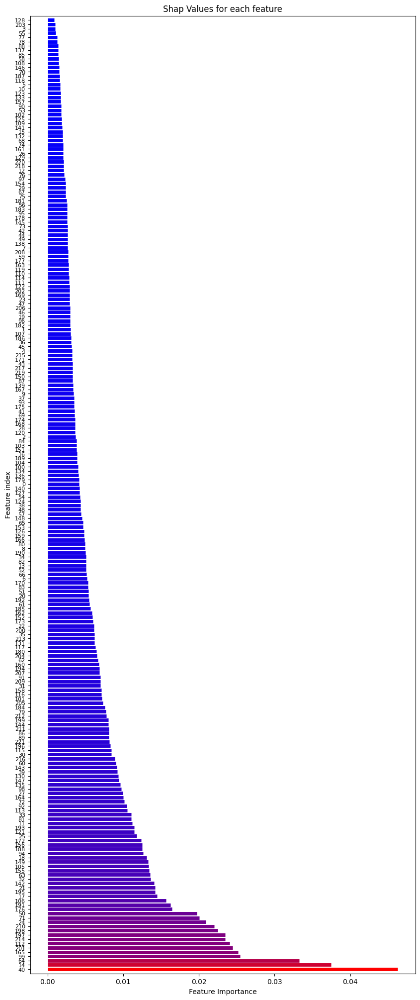

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors


# Create a colormap from blue to purple
cmap = colors.LinearSegmentedColormap.from_list("custom_blue_purple", ["blue", "red"])

# Normalize the SHAP values to the range [0, 1] for color mapping
norm = colors.Normalize(vmin=mean_abs_shap_df_sorted['SHAP'].min(), vmax=mean_abs_shap_df_sorted['SHAP'].max())

plt.figure(figsize=(10, 25))

# Assuming mean_abs_shap_df_sorted has a 'feature_index' column with the labels for the y-axis
y_ticks_labels = mean_abs_shap_df_sorted['feature_index'].tolist()

# Iterate through the DataFrame and plot each SHAP value as a horizontal line
for index, row in mean_abs_shap_df_sorted.iterrows():
    # Map the SHAP value to the colormap
    color = cmap(norm(row['SHAP']))
    plt.hlines(y=index, xmin=0, xmax=row['SHAP'], color=color, linestyle='-', linewidth=5)

# Adjust the y-axis limits to include all indices comfortably
plt.ylim(-1, len(mean_abs_shap_df_sorted))

# Set the y-axis ticks and labels with a smaller font size
plt.yticks(range(len(y_ticks_labels)), y_ticks_labels, fontsize= 8)  # You can also use a specific numeric value

plt.xlabel('Feature Importance')
plt.ylabel('Feature index')
plt.title('Shap Values for each feature')
plt.show()

In [ ]:
from scipy.stats import ttest_1samp 
from scipy.stats import shapiro
import statsmodels.stats.multitest as smm

tt_shap_pvalues = pd.DataFrame(index = range(shap_values.shape[1]), columns = ['mean','abs_mean','shapiro_pval','t_statistic', 'tt_p_value'])
tt_shap_pvalues["Feature"] = colnames[1:]
n_features = shap_values.shape[1]
for feature_id in range(n_features):
    feature_shap_values = shap_values[:, feature_id]
    
    t_statistic, p_value = ttest_1samp(feature_shap_values, 0, alternative='two-sided')
    shapiro_pval = shapiro(feature_shap_values)[1]
    tt_shap_pvalues.loc[feature_id, 'shapiro_pval'] = shapiro_pval
    tt_shap_pvalues.loc[feature_id, 't_statistic'] = t_statistic
    tt_shap_pvalues.loc[feature_id, 'tt_p_value'] = p_value
    tt_shap_pvalues.loc[feature_id, 'mean'] = feature_shap_values.mean()
    tt_shap_pvalues.loc[feature_id, 'abs_mean'] = np.abs(feature_shap_values).mean()

tt_shap_pvalues.loc[(tt_shap_pvalues['mean'] != 0) & (tt_shap_pvalues['shapiro_pval'] < 0.05)]

tt_shap_pvalues.loc[(tt_shap_pvalues['mean'] != 0) & (tt_shap_pvalues['tt_p_value'] < 0.05)]



# correction 

pvals = tt_shap_pvalues['tt_p_value'].astype(float)
rejected, pvals_corrected, _, _ = smm.multipletests(pvals, alpha=0.05, method='bonferroni')

# Add the corrected p-values to your DataFrame
tt_shap_pvalues['tt_p_value_corrected'] = pvals_corrected
tt_shap_pvalues['rejected'] = rejected  # True if hypothesis is rejected under FDR
filtered_results = tt_shap_pvalues.loc[(tt_shap_pvalues['mean'] != 0) & (tt_shap_pvalues['tt_p_value_corrected'] < 0.05)]

filtered_results_sorted = filtered_results.sort_values(by="abs_mean", ascending=False)

filtered_index = filtered_results_sorted.index
filtered_results_sorted

,mean,abs_mean,shapiro_pval,t_statistic,tt_p_value,Feature,tt_p_value_corrected,rejected
196,0.011246,0.01134,0.977702,7.686888,0.0,ko04614,0.000096,True
216,0.009081,0.010606,0.00163,5.410288,0.000039,ko00062,0.008556,True
213,0.006714,0.007273,0.037239,6.316153,0.000006,ko00965,0.001318,True
194,0.005709,0.006622,0.066205,4.938456,0.000106,ko05322,0.023552,True


In [ ]:
significant_rows = filtered_results_sorted
significant_rows.rename(columns={'abs_mean': 'SHAP'}, inplace=True)
significant_rows['feature_id'] = significant_rows.index
significant_rows.reset_index(drop=True, inplace=True)
significant_rows


,mean,SHAP,shapiro_pval,t_statistic,tt_p_value,Feature,tt_p_value_corrected,rejected,feature_id
0,0.011246,0.01134,0.977702,7.686888,0.0,ko04614,0.000096,True,196
1,0.009081,0.010606,0.00163,5.410288,0.000039,ko00062,0.008556,True,216
2,0.006714,0.007273,0.037239,6.316153,0.000006,ko00965,0.001318,True,213
3,0.005709,0.006622,0.066205,4.938456,0.000106,ko05322,0.023552,True,194


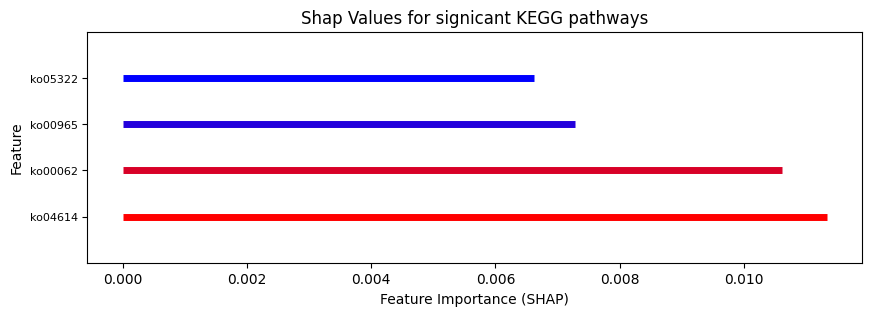

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors
# we will create same plot for only siggnificant features

# Create a colormap from blue to purple
cmap = colors.LinearSegmentedColormap.from_list("custom_blue_purple", ["blue", "red"])

# Normalize the SHAP values to the range [0, 1] for color mapping
norm = colors.Normalize(vmin=significant_rows['SHAP'].min(), vmax=significant_rows['SHAP'].max())

plt.figure(figsize=(10, 3))

# Assuming mean_abs_shap_df_sorted has a 'feature_index' column with the labels for the y-axis
y_ticks_labels = significant_rows['Feature'].tolist()

# Iterate through the DataFrame and plot each SHAP value as a horizontal line
for index, row in significant_rows.iterrows():
    # Map the SHAP value to the colormap
    color = cmap(norm(row['SHAP']))
    plt.hlines(y=index, xmin=0, xmax=row['SHAP'], color=color, linestyle='-', linewidth=5)

# Adjust the y-axis limits to include all indices comfortably
plt.ylim(-1, len(significant_rows))

# Set the y-axis ticks and labels with a smaller font size
plt.yticks(range(len(y_ticks_labels)), y_ticks_labels, fontsize= 8)  # You can also use a specific numeric value

plt.xlabel('Feature Importance (SHAP)')
plt.ylabel('Feature')
plt.title('Shap Values for signicant KEGG pathways')
plt.show()

Now we will visualise correlation in order to compare it to other approaches 

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Compute the correlation matrix
correlation_matrix = df.iloc[:,1:].corr(method='pearson')  # You can change 'pearson' to 'kendall' or 'spearman'


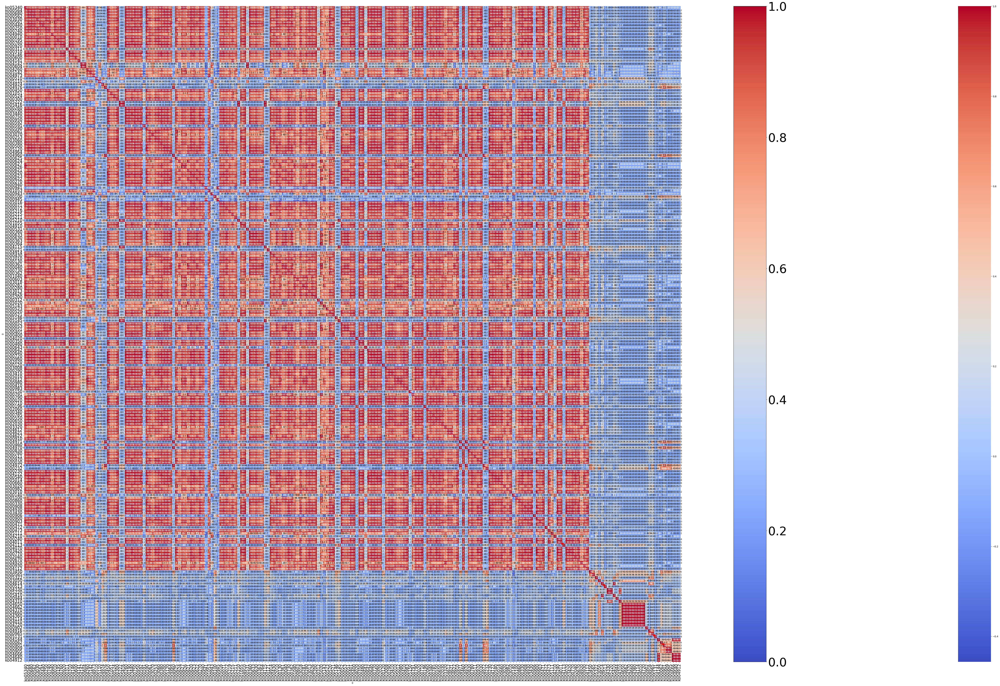

In [ ]:


plt.figure(figsize=(100,50))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.xticks(fontsize=17)
plt.yticks(fontsize=17)
plt.colorbar(plt.gca().imshow([[0, 1], [0, 1]], cmap='coolwarm')).ax.tick_params(labelsize=50)
plt.colorbar(plt.gca().imshow([[0, 1], [0, 1]], cmap='coolwarm')).remove()
#plt.savefig('heatmap_KEGG_pathways.png')
plt.show()

# Marking the indexes on the plot
plt.scatter([182, 196, 213, 216], [182, 196, 213, 216], marker='o', color='red', s=100)
plt.show()

